# To do
- define behaviors based on the UWB tracks
- create individual time-budget breakdowns
- time by velocity (activity plot)
- % time in zone
- How does invasion impact chase relationship structures?
- Begin offloading some of these functions into the package
- Make the preprocessing step as low level as possible, including for all plotting features as well. 


# Preprocessing UWB Data

In [2]:
import FieldNeuroToolbox as fnt
fnt.preprocess_uwb(downsample_rate='off',smoothing='savitzky-golay')

2024-12-20 15:44:42.115 python[33639:14369032] +[IMKInputSession subclass]: chose IMKInputSession_Modern


Selected SQLite database file path: /Users/caleb/Library/CloudStorage/GoogleDrive-vogtneuroscience@gmail.com/My Drive/Work/Projects/2024_LID_UWBBehavior/Data/T002/UltraWideBand/EchoDatabase.sqlite
Output directory: /Users/caleb/Library/CloudStorage/GoogleDrive-vogtneuroscience@gmail.com/My Drive/Work/Projects/2024_LID_UWBBehavior/Data/T002/UltraWideBand
Extracted trial ID: T002

Processing chunk 0 starting at offset 0 with 5950440 rows
Unique HexID values in uwb DataFrame: ['3026' '302e' '3012' '301a' '301e' '3019' '3021' '3043' '3045' '304f'
 '303c' '3048' '3047' '3051' '3041' '304e']
Rows after velocity filtering: 5481270 (removed 469170)
Number of single jumps detected and removed: 2046
Smoothed xy trajectories using Savitzky-Golay filter
Final number of rows in this chunk: 5479224


/Users/caleb/Documents/GitHub/FieldNeuroToolbox/FieldNeuroToolbox/uwb/preprocess_uwb.py:182: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  output_df = pd.concat([pd.read_csv(f) for f in chunk_files])


All chunks have been concatenated and saved to /Users/caleb/Library/CloudStorage/GoogleDrive-vogtneuroscience@gmail.com/My Drive/Work/Projects/2024_LID_UWBBehavior/Data/T002/UltraWideBand/T002_EchoDatabase_processed.csv. Chunk files have been deleted.
Preprocessed UWB data stored in output_df
5479224
  trial HexID                Timestamp  smoothed_x  smoothed_y  location_x  \
0  T002  3012  2024-12-04 14:48:40.860    2.088870    1.300438    2.082938   
1  T002  3012  2024-12-04 14:48:41.124    2.080818    1.291331    2.191207   
2  T002  3012  2024-12-04 14:48:41.267    2.073168    1.282616    2.080688   
3  T002  3012  2024-12-04 14:48:41.399    2.065920    1.274292    2.073565   
4  T002  3012  2024-12-04 14:48:41.531    2.059074    1.266360    2.034947   

   location_y  shortid  arenaid  arenaname  calculation_error  anchors_used  \
0    1.251143    12306        0        NaN           0.000000             5   
1    1.368985    12306        0        NaN           0.000000          

# Load Data

In [14]:
## Load the csv file containing the uwb data and load the arena coordinates information. 
import FieldNeuroToolbox as fnt
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import seaborn as sns
import numpy as np
import importlib
from tkinter import Tk
from tkinter.filedialog import askopenfilename

# Hide the root window
Tk().withdraw()

# Open a file dialog to select the UWB data CSV file
uwb_file = askopenfilename(title="Select UWB data CSV file", filetypes=[("CSV files", "*.csv")])
print("Selected UWB data CSV file path:", uwb_file)

# Load the data
uwb = pd.read_csv(uwb_file)
# print(uwb.head())


##### load arena coordinates from the wiser .xml configuration file
import xml.etree.ElementTree as ET
import pandas as pd
from tkinter import Tk
from tkinter.filedialog import askopenfilename

# Hide the root Tkinter window
Tk().withdraw()

# Open a file dialog to select the XML file
xml_file = askopenfilename(title="Select the Wiser UWB Arena configuration .XML file to get zone coordinates", filetypes=[("XML files", "*.xml")])
print("Selected XML file path:", xml_file)

# Parse the XML file
tree = ET.parse(xml_file)
root = tree.getroot()

# Initialize lists to store the extracted data
zone_names = []
x_coords = []
y_coords = []

# Iterate through the XML structure to extract zone names and coordinates
for zone in root.findall('.//Zone'):
    zone_name = zone.get('name')
    for point in zone.findall('.//Point'):
        x = float(point.get('x'))
        y = float(point.get('y'))
        zone_names.append(zone_name)
        x_coords.append(x)
        y_coords.append(y)

# Create a DataFrame from the extracted data
ArenaCoords = pd.DataFrame({
    'zone': zone_names,
    'x': x_coords,
    'y': y_coords
})

# Convert coordinates from inches to meters
ArenaCoords['x'] *= 0.0254
ArenaCoords['y'] *= 0.0254

# Print the DataFrame to confirm the extracted data
# print(ArenaCoords)

Selected UWB data CSV file path: /Users/caleb/Library/CloudStorage/GoogleDrive-vogtneuroscience@gmail.com/My Drive/Work/Projects/2024_LID_UWBBehavior/Results/T002_UltraWideBandDatabase_processed.csv
Selected XML file path: /Users/caleb/Library/CloudStorage/GoogleDrive-vogtneuroscience@gmail.com/My Drive/Work/Projects/2024_LID_UWBBehavior/Data/T002/UltraWideBand/EchoConfiguration_2024.12.4.xml


## Create multi-animal path animation 

To do: 
- implement data_viz multi quadrant graphing

In [6]:
fnt.animate_path(data=uwb, filter_subject="all", filter_day="1,2", filter_hours="all",filter_minutes="all",
             time_window=10,trailing_window=120, fps=30, color_by="sex",arena_coordinates=ArenaCoords);


Creating frames: 100%|██████████| 8170/8170 [10:44:13<00:00,  4.73s/it] 


Animation saved as C:\Users\caleb\Desktop\animation_frames\T002_Day1_animation.mp4
All PNG files have been deleted.


Creating frames:  62%|██████▏   | 4686/7565 [13:59:19<13:14:55, 16.57s/it]

: 

## Plot the paths of individual animals

In [15]:
## define and load the plot_path function
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.patches import Polygon

def plot_uwb_path(df, filter_by="all", filter_day="all", arena_coordinates="none"):
    """
    Plots the smoothed trajectories of animals based on the specified filter.

    Parameters:
    df (pd.DataFrame): The DataFrame containing the tracking data with columns ID, Sex, Timestamp, Day, smoothed_x, and smoothed_y.
    filter_by (str): Can be "males", "females", "[specific ID]", or "all".
    filter_day (str or int): Defines the day(s) to include in the plot. Can be "all", a single day (e.g., 1), or a range (e.g., "1,5").
    arena_coordinates (str or pd.DataFrame): DataFrame with arena coordinates or "none". Default is "none".
    
    Example usage
    plot_path(df, filter_by="all", filter_day="all", arena_coordinates=ArenaCoords)   

    """
    # Filter the DataFrame based on the filter_by argument
    if filter_by.lower() == "males":
        df_filtered = df[df['sex'] == 'M']
    elif filter_by.lower() == "females":
        df_filtered = df[df['sex'] == 'F']
    elif filter_by.lower() != "all":
        df_filtered = df[df['ID'] == filter_by]
    else:
        df_filtered = df  # No filtering, use the entire DataFrame

    # Filter the DataFrame based on the filter_day argument
    if filter_day != "all":
        # Parse the filter_day argument
        day_range = [int(day) for day in str(filter_day).split(',')]
        if len(day_range) == 1:
            # Filter for a single day
            df_filtered = df_filtered[df_filtered['Day'] == day_range[0]]
        elif len(day_range) == 2:
            # Filter for a range of days
            df_filtered = df_filtered[(df_filtered['Day'] >= day_range[0]) & (df_filtered['Day'] <= day_range[1])]

    # Plot trajectory across days for the filtered data
    sns.set(style="whitegrid")
    g = sns.FacetGrid(df_filtered, col="Day", col_wrap=4, height=3, aspect=1.5, hue="ID", palette="tab10")

    # Plot each animal's trajectory with distinct colors
    g.map(plt.plot, "smoothed_x", "smoothed_y", marker="o", linestyle='-', linewidth=0.5, markersize=0.75, zorder=1)

    # Set titles and labels
    g.set_axis_labels("X Coordinate (meters)", "Y Coordinate (meters)")
    g.set_titles("Day {col_name}")

    # Check if arena_coordinates is provided
    if isinstance(arena_coordinates, pd.DataFrame):
        # Validate the columns of the DataFrame
        expected_columns = ['zone', 'x', 'y']
        if list(arena_coordinates.columns) != expected_columns:
            print("arena_coordinates argument expects a dataframe with three columns: zone, x, y.")
            return

        # Draw polygons for each zone
        for ax in g.axes.flat:
            for zone in arena_coordinates['zone'].unique():
                zone_coords = arena_coordinates[arena_coordinates['zone'] == zone]
                polygon = Polygon(zone_coords[['x', 'y']].values, closed=True, edgecolor='black', linewidth=2, facecolor='none', zorder=2)
                ax.add_patch(polygon)
                # Calculate the center of the polygon to place the label
                center_x = zone_coords['x'].mean()
                center_y = zone_coords['y'].mean()
                ax.text(center_x, center_y, zone, ha='center', va='center', fontsize=8, color='black', zorder=3)

    else:
        print("Plot produced with no arena coordinates.")

    # Adjust legend to show only distinct animal codes
    g.add_legend(title="Animal Code")
    plt.show()

T002 Paths

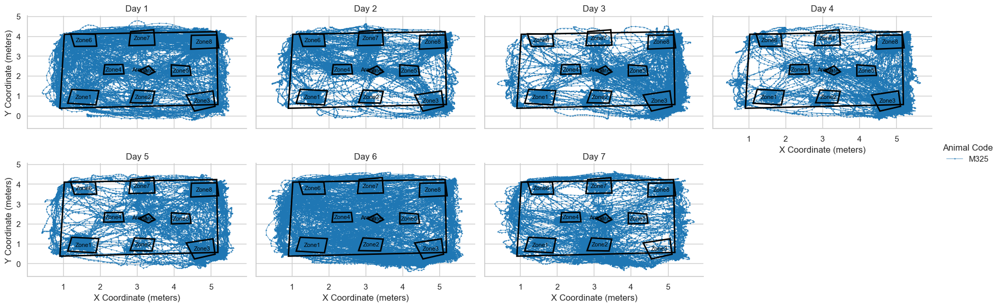

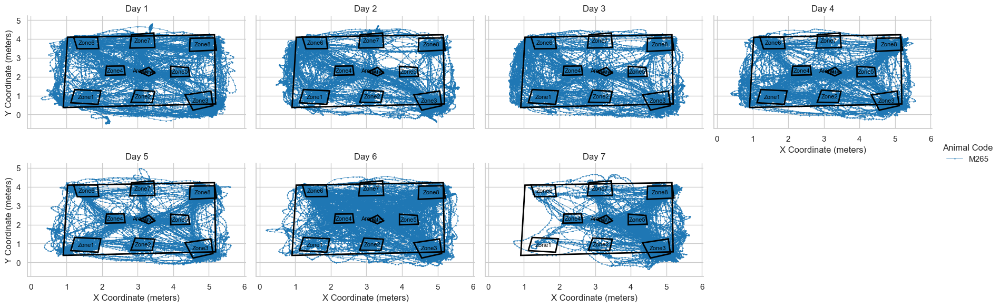

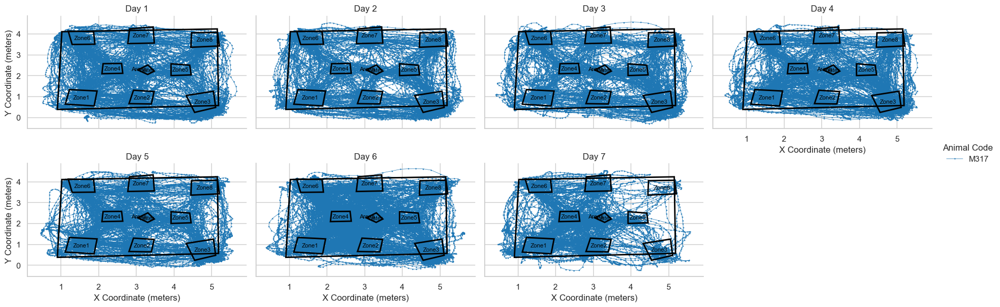

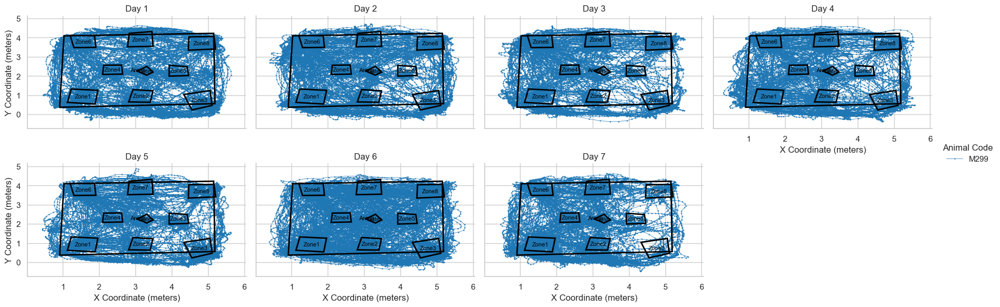

In [16]:
# plot_uwb_path(uwb, filter_by="all",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="M325",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="M265",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="M317",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="M299",filter_day="all",arena_coordinates=ArenaCoords)


T002 Females

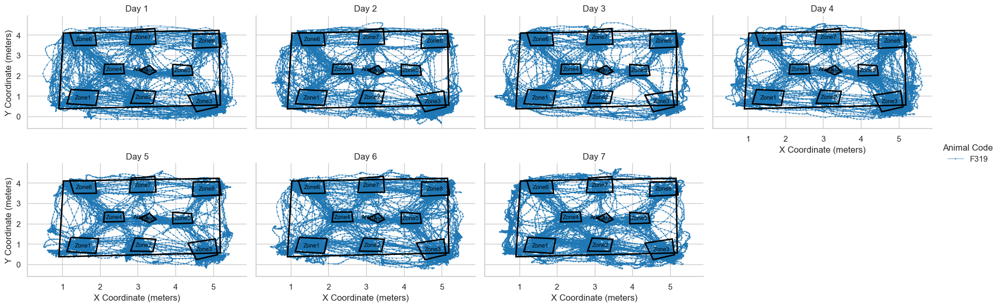

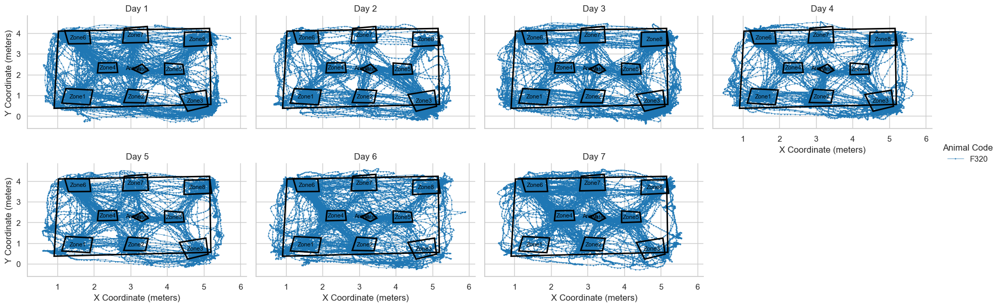

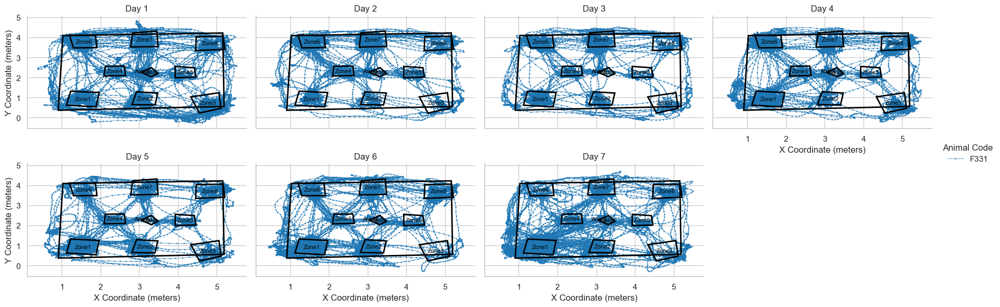

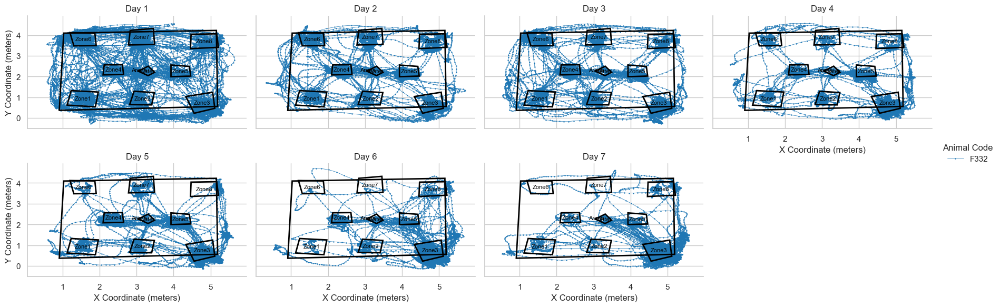

In [17]:

plot_uwb_path(uwb, filter_by="F319",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="F320",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="F331",filter_day="all",arena_coordinates=ArenaCoords)
plot_uwb_path(uwb, filter_by="F332",filter_day="all",arena_coordinates=ArenaCoords)



T001 Paths

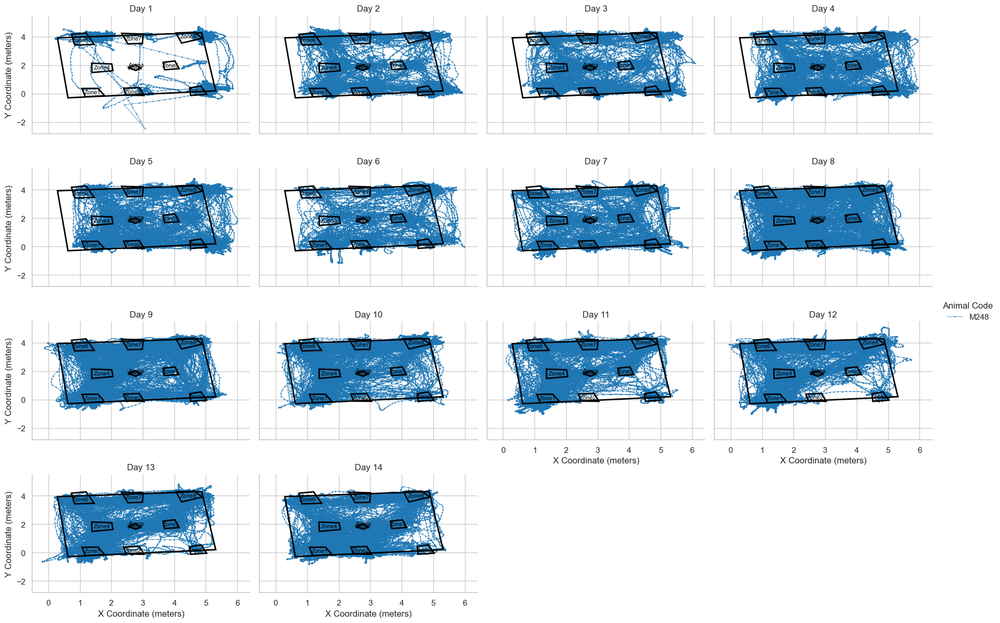

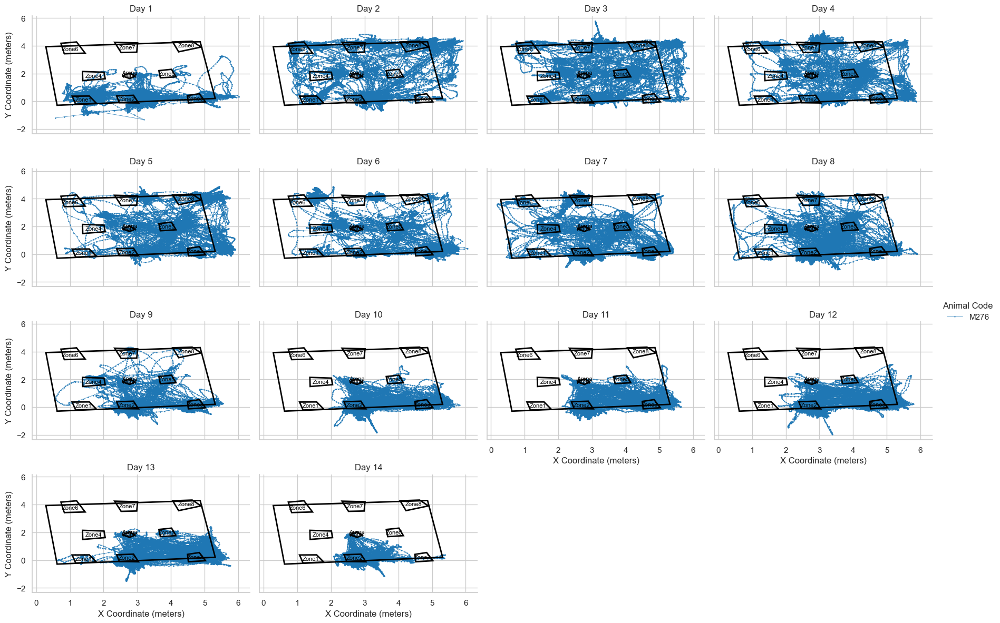

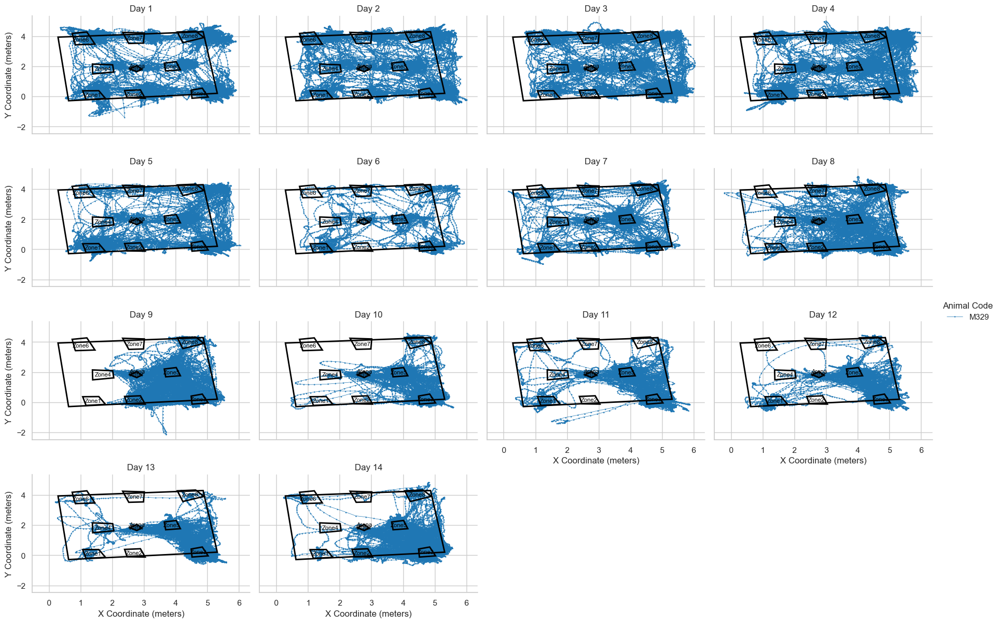

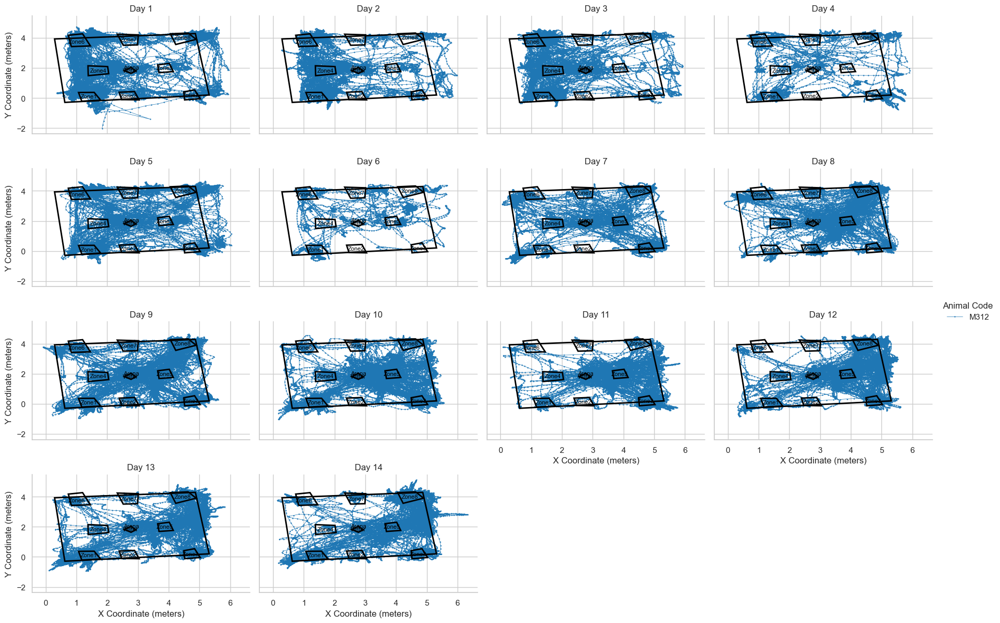

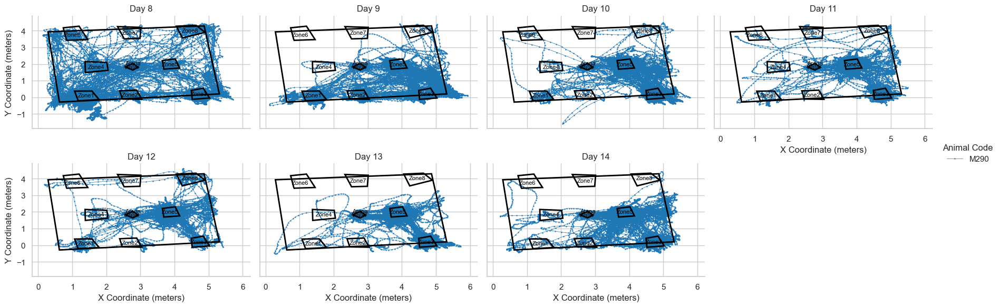

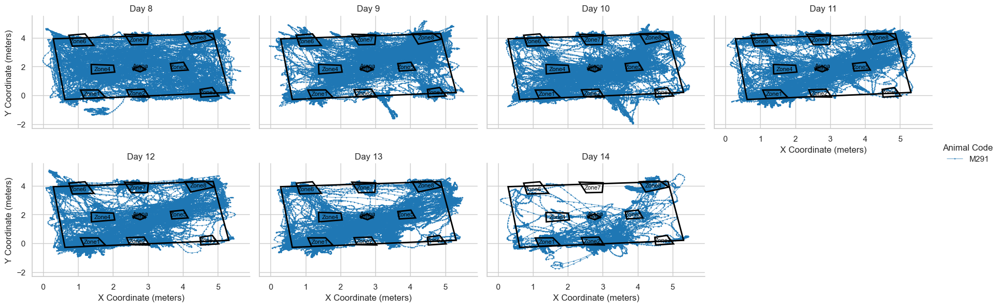

In [ ]:
## plot indiviaual animal paths by ID

# plot_path(uwb, filter_by="all",filter_day="all",arena_coordinates=ArenaCoords)
# plot_uwb_path(uwb, filter_by="M248",filter_day="all",arena_coordinates=ArenaCoords)
# plot_uwb_path(uwb, filter_by="M276",filter_day="all",arena_coordinates=ArenaCoords)
# plot_uwb_path(uwb, filter_by="M329",filter_day="all",arena_coordinates=ArenaCoords)
# plot_uwb_path(uwb, filter_by="M312",filter_day="all",arena_coordinates=ArenaCoords)
# plot_uwb_path(uwb, filter_by="M290",filter_day="all",arena_coordinates=ArenaCoords)
# plot_uwb_path(uwb, filter_by="M291",filter_day="all",arena_coordinates=ArenaCoords)

## Plot occupancy heatmap, 2D (testing)

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

def plot_occupancy_heatmap_2d(data, subject):
    # Filter the DataFrame for the specific animal
    df_filtered = data[data['ID'] == subject]
    
    # Get unique days for the animal
    unique_days = df_filtered['Day'].unique()
    
    # Create a list to store the data for each day
    data_list = []
    
    for day in unique_days:
        # Filter the DataFrame for the specific day
        df_day_filtered = df_filtered[df_filtered['Day'] == day]
        
        # Create a 2D histogram of the x and y coordinates
        x = df_day_filtered['smoothed_x']
        y = df_day_filtered['smoothed_y']
        occupancy, xedges, yedges = np.histogram2d(x, y, bins=50)
        
        # Create meshgrid for the heatmap
        xcenters = (xedges[:-1] + xedges[1:]) / 2
        ycenters = (yedges[:-1] + yedges[1:]) / 2
        X, Y = np.meshgrid(xcenters, ycenters)
        
        # Store the data in a dictionary
        data_list.append({
            'day': day,
            'X': X,
            'Y': Y,
            'occupancy': occupancy.T
        })
    
    # Create a facet grid
    num_days = len(unique_days)
    fig, axes = plt.subplots(1, num_days, figsize=(6 * num_days, 6))
    
    if num_days == 1:
        axes = [axes]
    
    for ax, data in zip(axes, data_list):
        sns.heatmap(data['occupancy'], ax=ax, cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
        ax.set_xlabel('X Coordinate')
        ax.set_ylabel('Y Coordinate')
        ax.set_title(f'Occupancy Heatmap for {subject} on Day {data["day"]}')
    
    plt.tight_layout()
    plt.show()

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

def plot_occupancy_heatmap_2d(data, subject):
    # Filter the DataFrame for the specific animal
    df_filtered = data[data['ID'] == subject]
    
    # Get unique days for the animal
    unique_days = df_filtered['Day'].unique()
    
    # Create a list to store the data for each day
    data_list = []
    
    for day in unique_days:
        # Filter the DataFrame for the specific day
        df_day_filtered = df_filtered[df_filtered['Day'] == day]
        
        # Create a 2D histogram of the x and y coordinates
        x = df_day_filtered['smoothed_x']
        y = df_day_filtered['smoothed_y']
        occupancy, xedges, yedges = np.histogram2d(x, y, bins=50)
        
        # Create meshgrid for the heatmap
        xcenters = (xedges[:-1] + xedges[1:]) / 2
        ycenters = (yedges[:-1] + yedges[1:]) / 2
        X, Y = np.meshgrid(xcenters, ycenters)
        
        # Store the data in a dictionary
        data_list.append({
            'day': day,
            'X': X,
            'Y': Y,
            'occupancy': occupancy.T
        })
    
    # Create a facet grid with 4 plots per row
    num_days = len(unique_days)
    num_cols = 4
    num_rows = (num_days + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 6 * num_rows))
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    for ax, data in zip(axes, data_list):
        sns.heatmap(data['occupancy'], ax=ax, cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
        ax.set_xlabel('X Coordinate')
        ax.set_ylabel('Y Coordinate')
        ax.set_title(f'Occupancy Heatmap for {subject} on Day {data["day"]}')
    
    # Hide any unused subplots
    for i in range(len(data_list), len(axes)):
        fig.delaxes(axes[i])
    
    plt.tight_layout()
    plt.show()

# Example usage
# plot_occupancy_heatmap_2d(data=uwb, subject='M248')

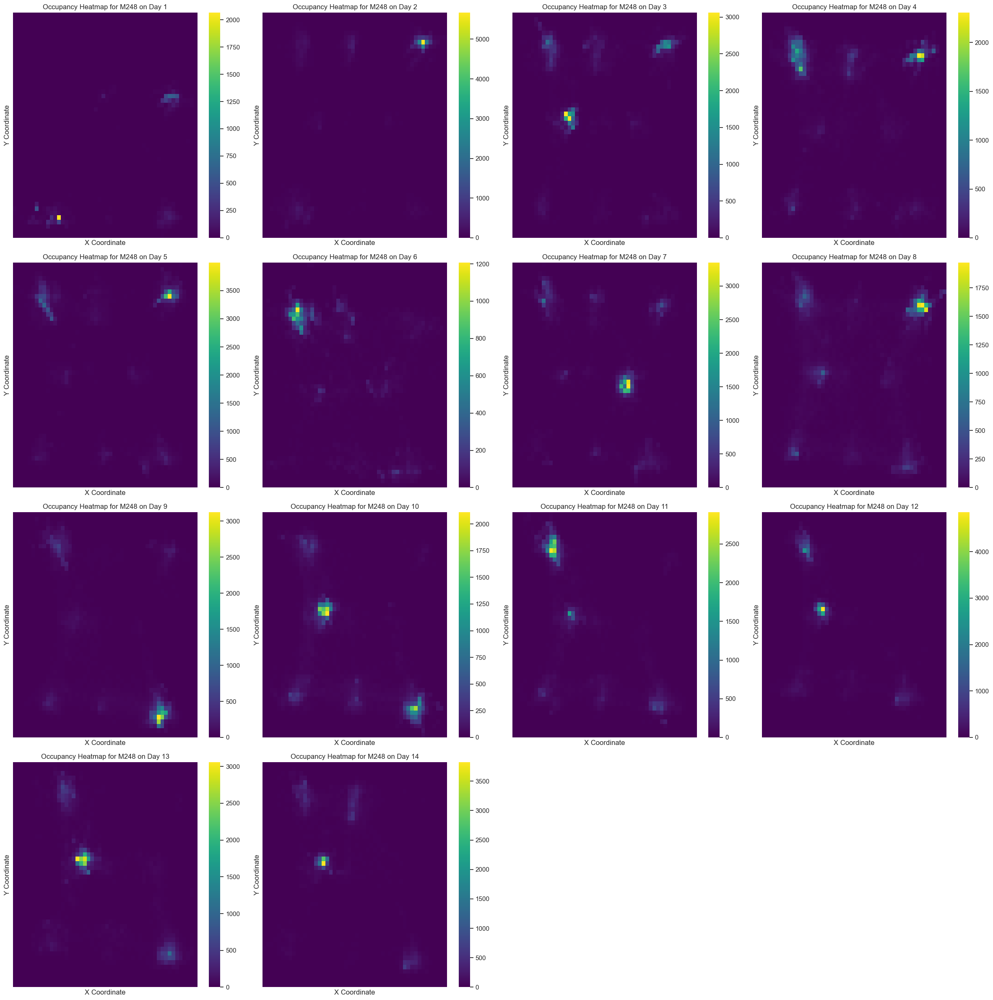

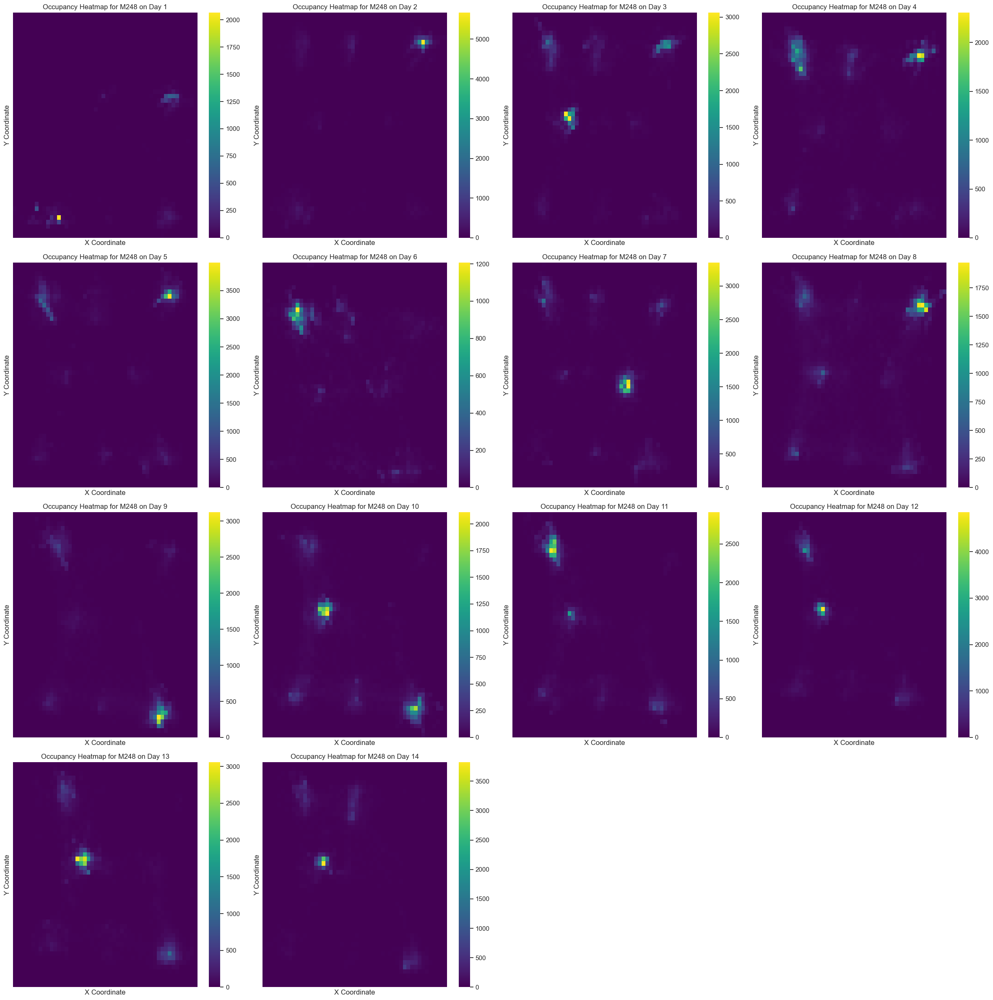

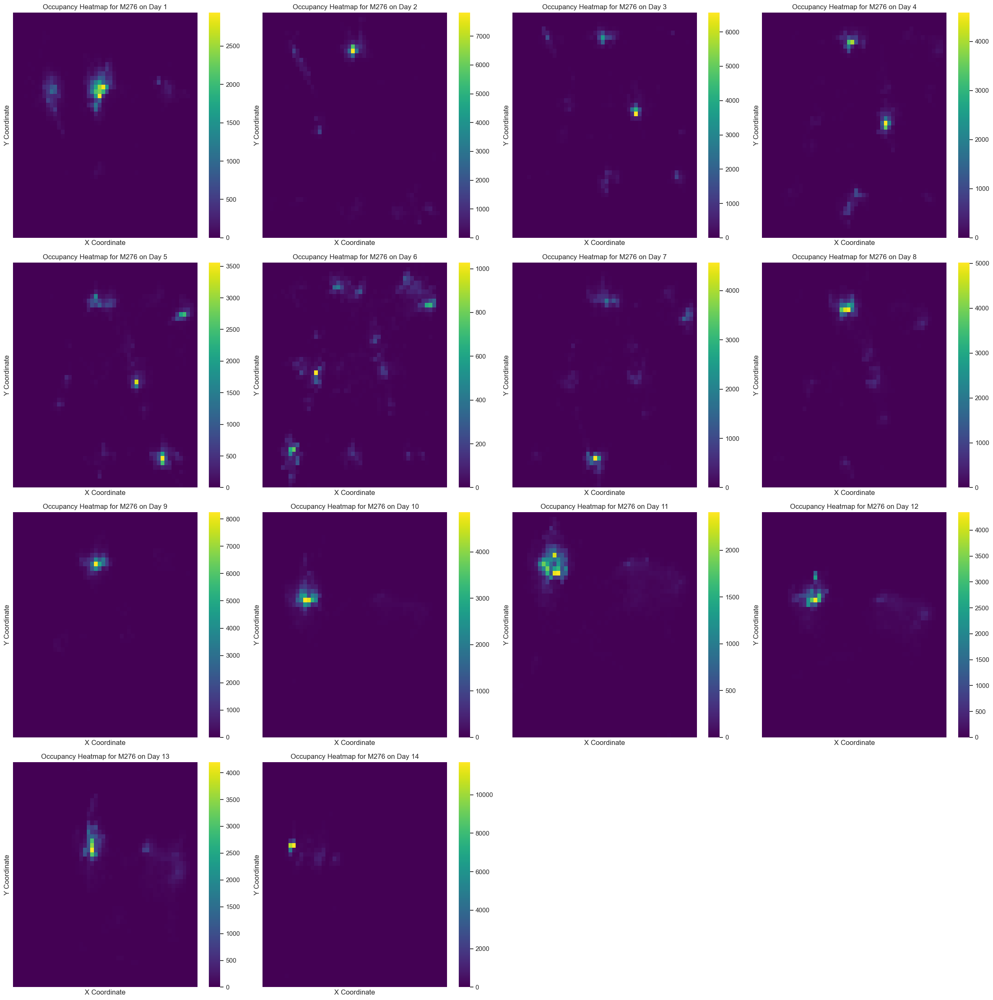

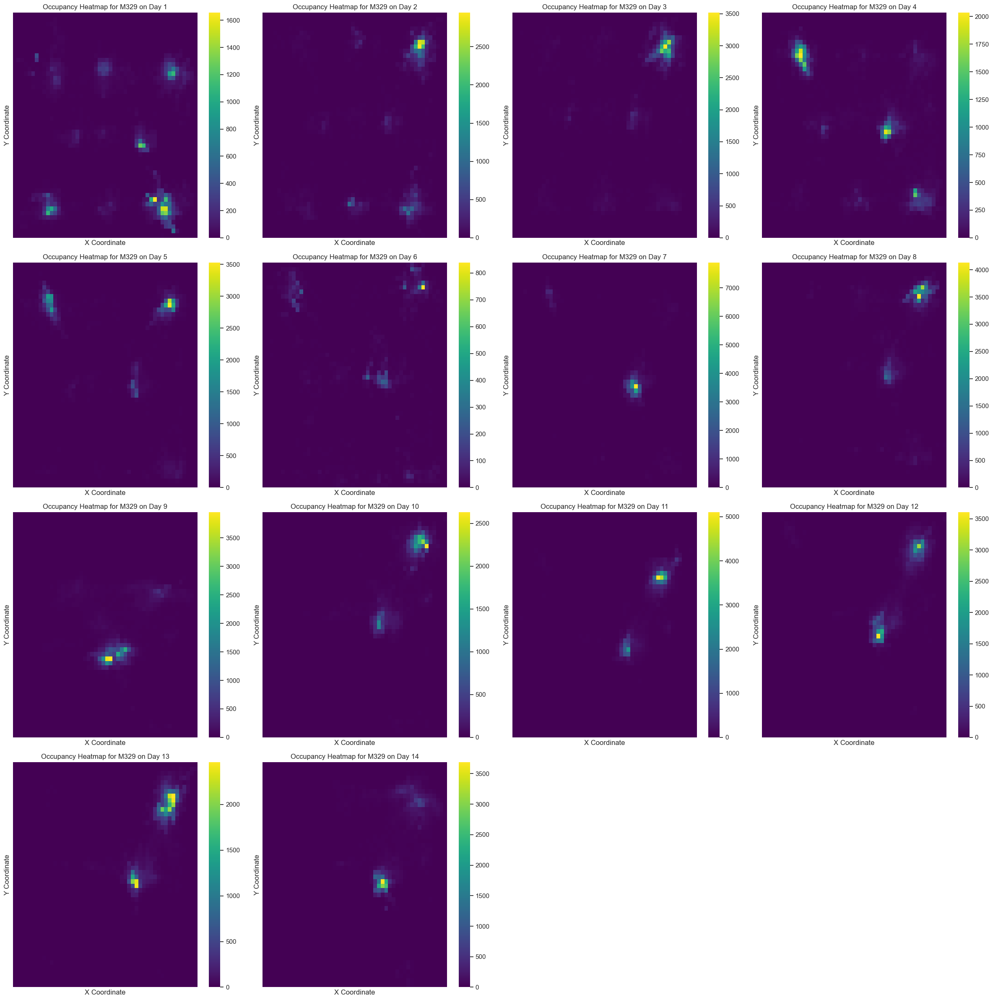

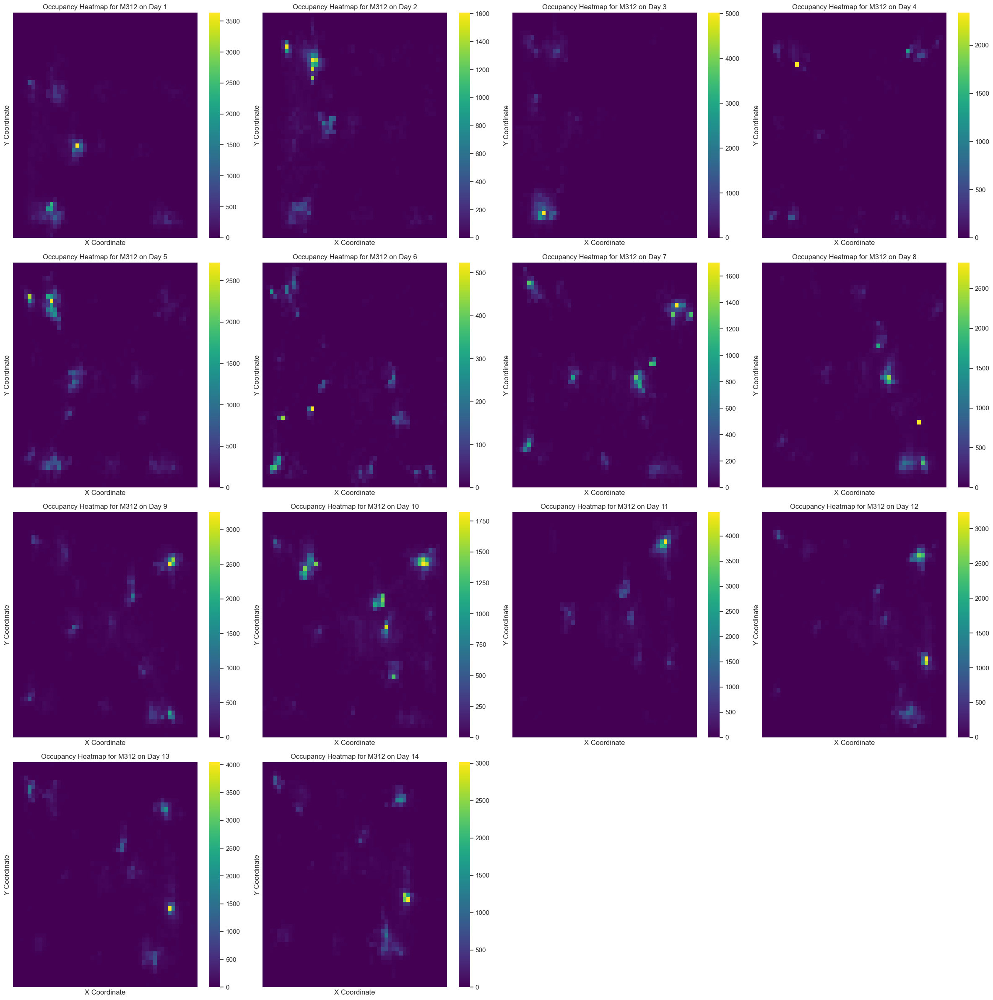

In [ ]:
# Example usage
plot_occupancy_heatmap_2d(data=uwb, subject='M248')
plot_occupancy_heatmap_2d(data=uwb, subject='M276')
plot_occupancy_heatmap_2d(data=uwb, subject='M329')
plot_occupancy_heatmap_2d(data=uwb, subject='M312')

## Plot occupancy heatmap, 3D

In [9]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

def plot_occupancy_heatmap(data, filter_subject, occupancy_scale="all"):
    # Filter the DataFrame for the specific animal
    df_filtered = data[data['ID'] == filter_subject]
    
    # Get unique days for the animal
    unique_days = df_filtered['Day'].unique()
    
    # Create a list to store the data for each day
    data_list = []
    max_occupancy = 0
    
    for day in unique_days:
        # Filter the DataFrame for the specific day
        df_day_filtered = df_filtered[df_filtered['Day'] == day]
        
        # Create a 2D histogram of the x and y coordinates
        x = df_day_filtered['smoothed_x']
        y = df_day_filtered['smoothed_y']
        occupancy, xedges, yedges = np.histogram2d(x, y, bins=50)
        
        # Update the maximum occupancy if needed
        if occupancy_scale == "all":
            max_occupancy = max(max_occupancy, occupancy.max())
        
        # Create meshgrid for the surface plot
        xcenters = (xedges[:-1] + xedges[1:]) / 2
        ycenters = (yedges[:-1] + yedges[1:]) / 2
        X, Y = np.meshgrid(xcenters, ycenters)
        
        # Store the data in a dictionary
        data_list.append({
            'day': day,
            'X': X,
            'Y': Y,
            'occupancy': occupancy.T
        })
    
    # Create a facet grid with 5 plots per row
    num_days = len(unique_days)
    num_cols = 5
    num_rows = (num_days + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 6 * num_rows), subplot_kw={'projection': '3d'})
    
    # Flatten the axes array for easy iteration
    axes = axes.flatten()
    
    for ax, data in zip(axes, data_list):
        ax.plot_surface(data['X'], data['Y'], data['occupancy'], cmap='viridis', edgecolor='none')
        ax.set_xlabel('X Coordinate (m)')
        ax.set_ylabel('Y Coordinate (m)')
        ax.set_zlabel('Occupancy')
        ax.set_title(f'Occupancy Heatmap for {filter_subject} on Day {data["day"]}')
        
        # Set the viewing angle
        ax.view_init(elev=30, azim=250)  # Adjust the elevation and azimuth angles as needed
        
        # Set the z-axis limit based on occupancy_scale
        if occupancy_scale == "all":
            ax.set_zlim(0, max_occupancy)
    
    # Hide any unused subplots
    for i in range(len(data_list), len(axes)):
        fig.delaxes(axes[i])
    
    plt.tight_layout()
    plt.show()

# Example usage
# plot_occupancy_heatmap(data, 'M248', occupancy_scale="all")

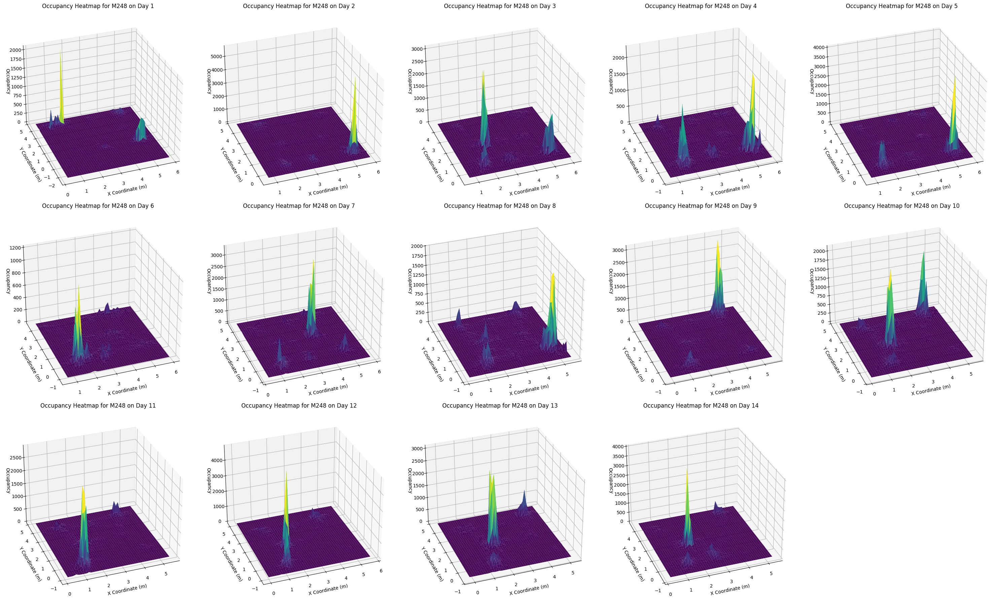

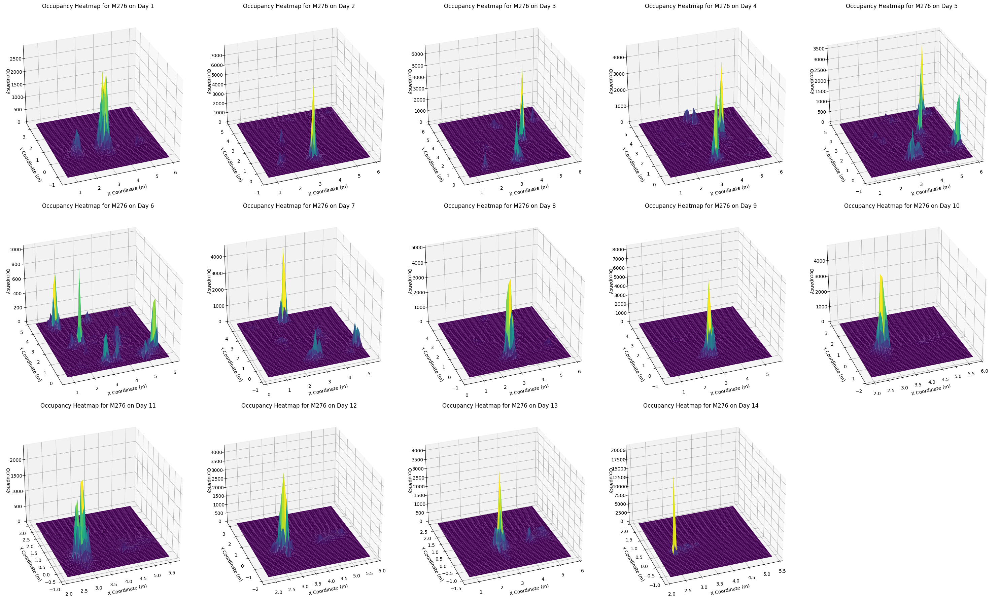

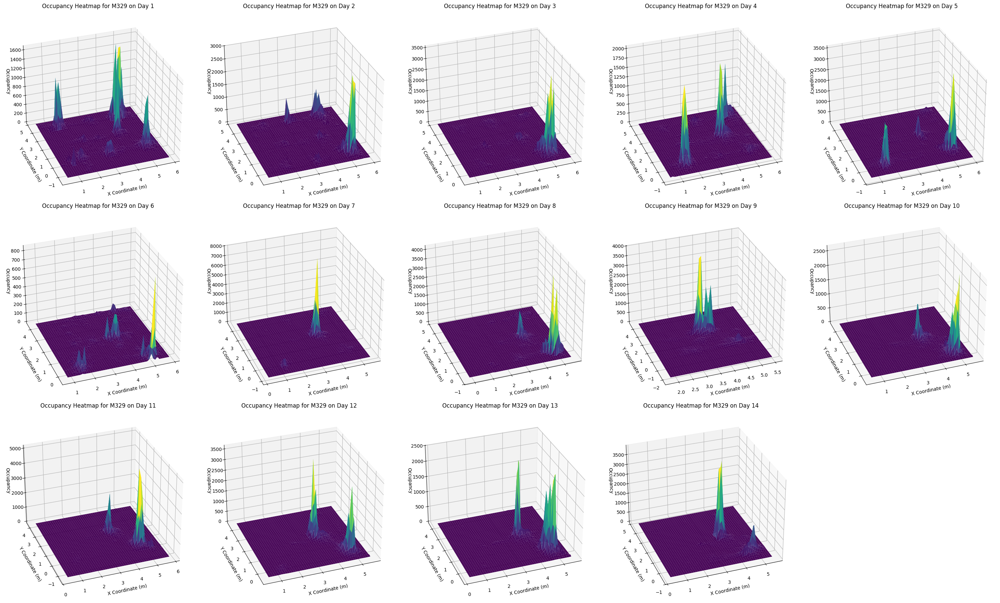

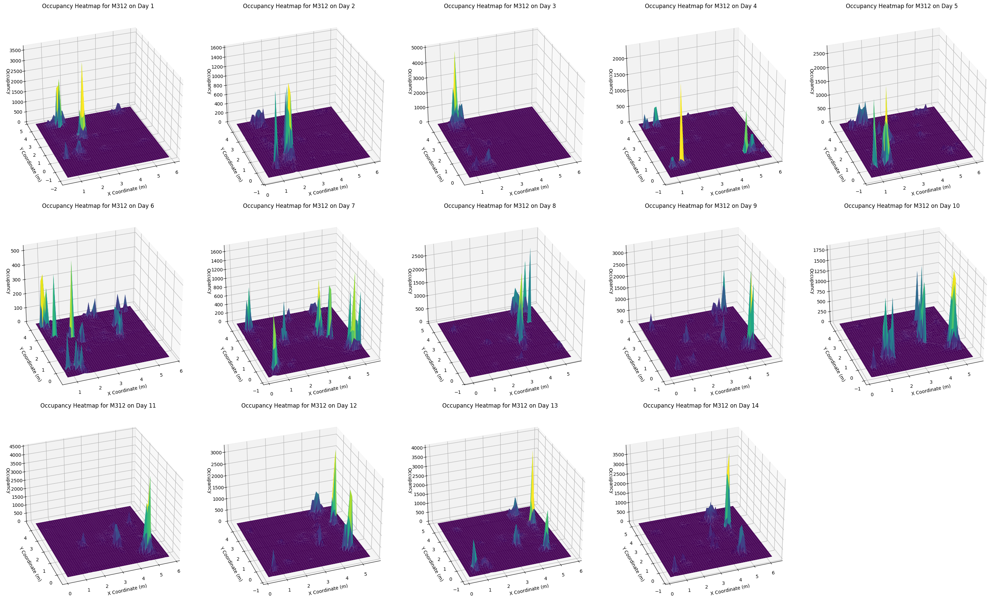

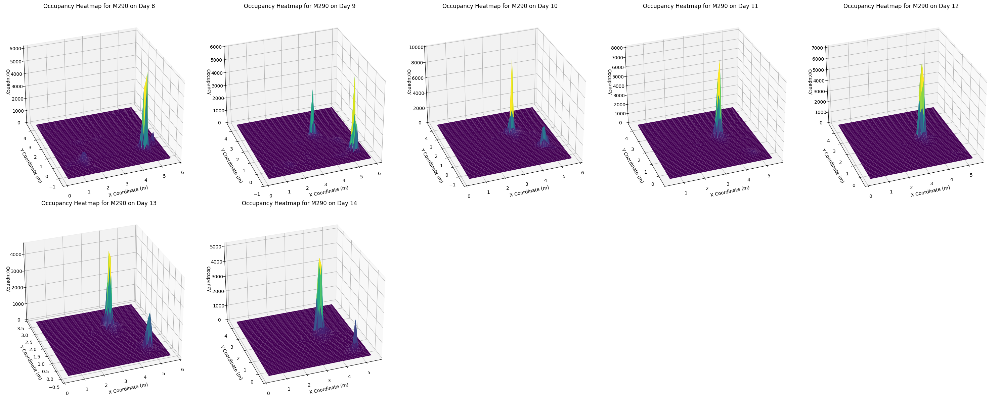

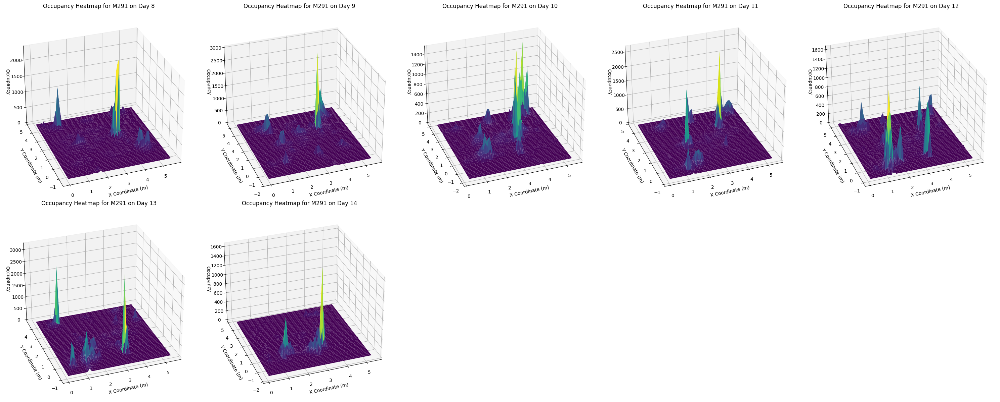

In [10]:
## scaled across days within animal. 
# plot_occupancy_heatmap(data=uwb, filter_subject='M248', occupancy_scale="all")
# plot_occupancy_heatmap(data=uwb, filter_subject='M276', occupancy_scale="all")
# plot_occupancy_heatmap(data=uwb, filter_subject='M329', occupancy_scale="all")
# plot_occupancy_heatmap(data=uwb, filter_subject='M312', occupancy_scale="all")
# plot_occupancy_heatmap(data=uwb, filter_subject='M290', occupancy_scale="all")
# plot_occupancy_heatmap(data=uwb, filter_subject='M291', occupancy_scale="all")

# Make the plots
plot_occupancy_heatmap(data=uwb, filter_subject='M248', occupancy_scale="daily")
plot_occupancy_heatmap(data=uwb, filter_subject='M276', occupancy_scale="daily")
plot_occupancy_heatmap(data=uwb, filter_subject='M329', occupancy_scale="daily")
plot_occupancy_heatmap(data=uwb, filter_subject='M312', occupancy_scale="daily")
plot_occupancy_heatmap(data=uwb, filter_subject='M290', occupancy_scale="daily")
plot_occupancy_heatmap(data=uwb, filter_subject='M291', occupancy_scale="daily")


## Circadian actogram
- Check that the velocity is calculated grouped by ID, Timestamp


In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def plot_actogram(data, filter_subject="all", filter_day="all", velocity_threshold=0.1):
    """
    Plots an actogram for each animal.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data. Must include columns 'Timestamp', 'smoothed_x', 'smoothed_y', 'ID', and 'Day'.
    filter_subject (str): The filter criteria for the data. Options are "all", "males", "females", or a specific animal ID. Default is "all".
    filter_day (str): The days to include in the plot, specified as a comma-separated string of day numbers (e.g., "1,2,3") or "all" for all days. Default is "all".
    velocity_threshold (float): The velocity threshold to define activity. Default is 0.1 m/s.
    """
    # Ensure Timestamp is in datetime format
    data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')

    # Check for NaT values in Timestamp
    if data['Timestamp'].isna().sum() > 0:
        raise ValueError("Timestamp column contains NaT values")

    # Filter the DataFrame based on the filter_subject argument
    if filter_subject.lower() == "males":
        df_filtered = data[data['sex'] == 'M']
    elif filter_subject.lower() == "females":
        df_filtered = data[data['sex'] == 'F']
    elif filter_subject.lower() != "all":
        df_filtered = data[data['ID'] == filter_subject]
    else:
        df_filtered = data  # No filtering, use the entire DataFrame

    # Process the filter_day argument
    if filter_day.lower() != "all":
        day_range = [int(day) for day in str(filter_day).split(',')]
        df_filtered = df_filtered[df_filtered['Day'].isin(day_range)]

    # Calculate the velocity on the filtered data
    df_filtered = df_filtered.sort_values(by='Timestamp')
    df_filtered['velocity'] = np.sqrt(df_filtered['smoothed_x'].diff()**2 + df_filtered['smoothed_y'].diff()**2) / df_filtered['Timestamp'].diff().dt.total_seconds()

    # Define activity as velocity above the specified threshold
    df_filtered['active'] = df_filtered['velocity'] > velocity_threshold

    # Plot the actogram
    plt.figure(figsize=(6, 3.5))
    for ID in df_filtered['ID'].unique():
        df_id_filtered = df_filtered[df_filtered['ID'] == ID]
        for day in df_id_filtered['Day'].unique():
            df_day_filtered = df_id_filtered[df_id_filtered['Day'] == day]
            active_times = df_day_filtered[df_day_filtered['active']]['Timestamp']
            hours = active_times.dt.hour + active_times.dt.minute / 60.0
            for hour in hours:
                plt.plot([hour, hour], [day - 0.5, day + 0.5], color='black')

        # Add gray shading for dark periods
        plt.axvspan(15, 25, color='gray', alpha=0.3)
        plt.axvspan(0, 3, color='gray', alpha=0.3)

        plt.xlabel('Hour of Day')
        plt.ylabel('Day of Trial')
        plt.title(f'{ID} - Actogram of Activity')
        plt.gca().invert_yaxis()
        plt.yticks(range(1, df_filtered['Day'].max() + 1))
        plt.grid(False)
        plt.show()

# Example usage
# plot_actogram(uwb, filter_subject="all", filter_day="1,2,3", velocity_threshold=0.15)

T002 actograms

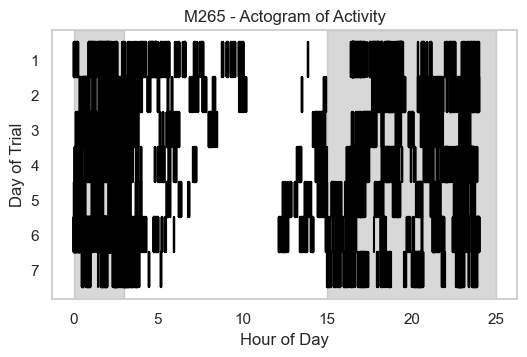

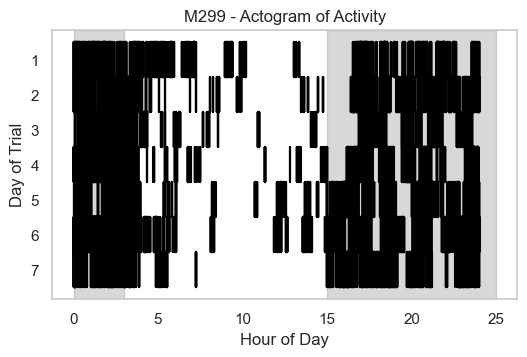

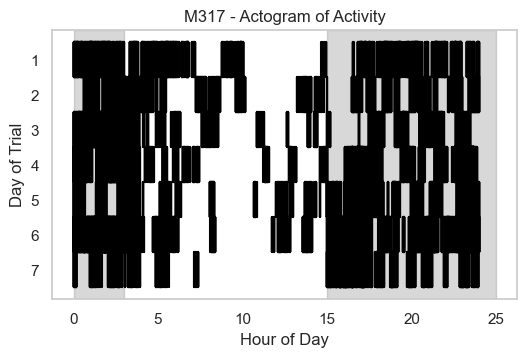

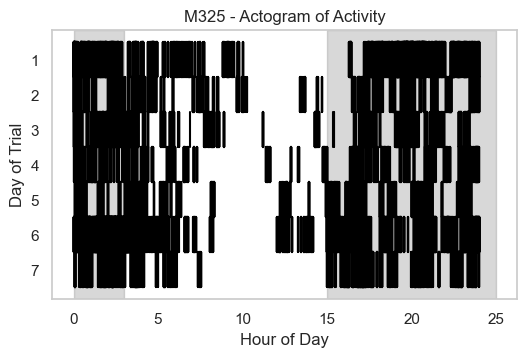

In [11]:
plot_actogram(uwb, filter_subject="M265", filter_day="all")
plot_actogram(uwb, filter_subject="M299", filter_day="all")
plot_actogram(uwb, filter_subject="M317", filter_day="all")
plot_actogram(uwb, filter_subject="M325", filter_day="all")

T001 Actograms

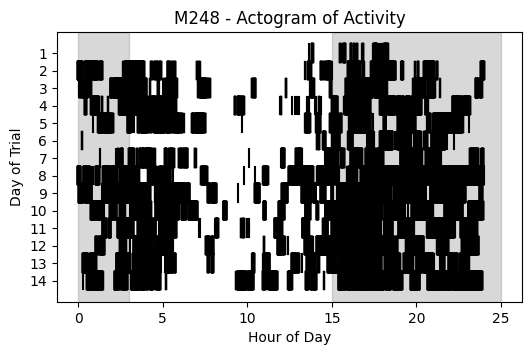

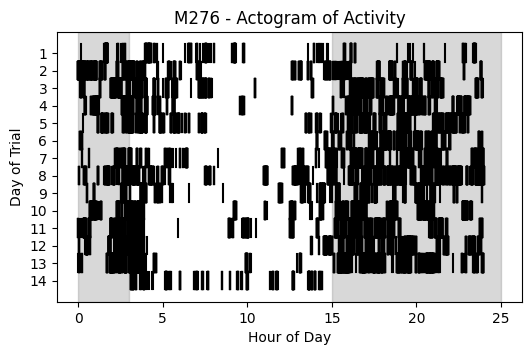

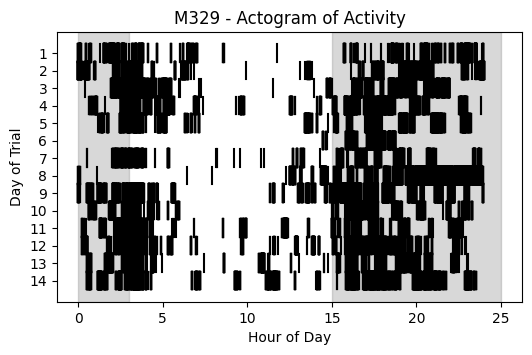

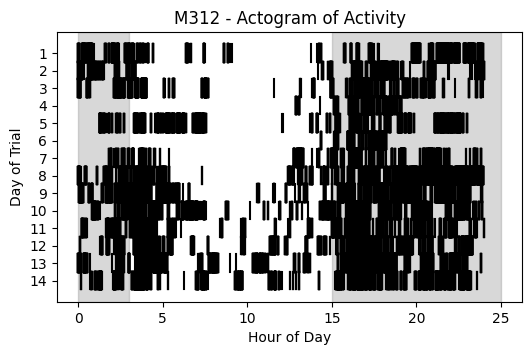

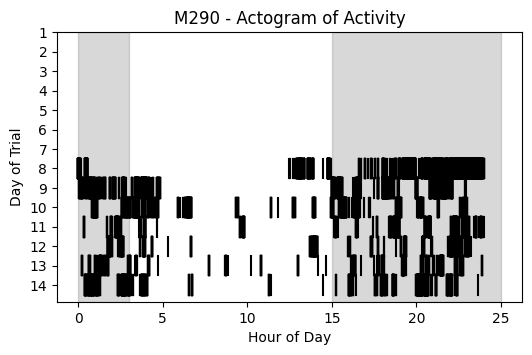

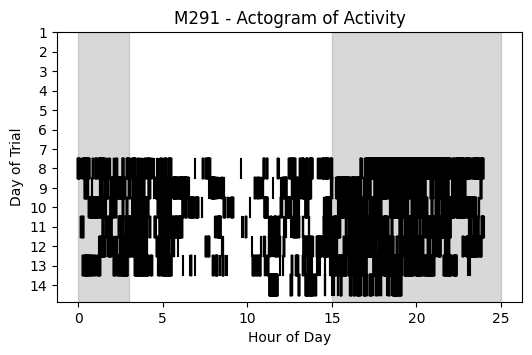

In [21]:
plot_actogram(uwb, filter_subject="M248", filter_day="all")
plot_actogram(uwb, filter_subject="M276", filter_day="all")
plot_actogram(uwb, filter_subject="M329", filter_day="all")
plot_actogram(uwb, filter_subject="M312", filter_day="all")
plot_actogram(uwb, filter_subject="M290", filter_day="all")
plot_actogram(uwb, filter_subject="M291", filter_day="all")

## Plot velocity over time
- Confirm velocity calculated grouped by ID, Timestamp

In [ ]:
## testing

import pandas as pd
import matplotlib.pyplot as plt

def plot_velocity_over_time(data, filter_subject="all", filter_day="all"):
    """
    Plots the velocity of the animal over time.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data. Must include columns 'Timestamp', 'smoothed_x', 'smoothed_y', 'ID', and 'Day'.
    filter_subject (str): The filter criteria for the data. Options are "all", "males", "females", or a specific animal ID. Default is "all".
    filter_day (str): The days to include in the plot, specified as a comma-separated string of day numbers (e.g., "1,2,3") or "all" for all days. Default is "all".
    """
    # Ensure Timestamp is in datetime format
    data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')

    # Check for NaT values in Timestamp
    if data['Timestamp'].isna().sum() > 0:
        raise ValueError("Timestamp column contains NaT values")

    # Filter the DataFrame based on the filter_subject argument
    if filter_subject.lower() == "males":
        df_filtered = data[data['sex'] == 'M']
    elif filter_subject.lower() == "females":
        df_filtered = data[data['sex'] == 'F']
    elif filter_subject.lower() != "all":
        df_filtered = data[data['ID'] == filter_subject]
    else:
        df_filtered = data  # No filtering, use the entire DataFrame

    # Process the filter_day argument
    if filter_day.lower() != "all":
        day_range = [int(day) for day in str(filter_day).split(',')]
        df_filtered = df_filtered[df_filtered['Day'].isin(day_range)]

    # Calculate the velocity
    df_filtered = df_filtered.sort_values(by='Timestamp')
    df_filtered['velocity'] = np.sqrt(df_filtered['smoothed_x'].diff()**2 + df_filtered['smoothed_y'].diff()**2) / df_filtered['Timestamp'].diff().dt.total_seconds()

    # Plot the velocity over time
    plt.figure(figsize=(12, 6))
    for ID in df_filtered['ID'].unique():
        df_id_filtered = df_filtered[df_filtered['ID'] == ID]
        plt.plot(df_id_filtered['Timestamp'], df_id_filtered['velocity'], label=f'ID: {ID}')

    plt.xlabel('Time')
    plt.ylabel('Velocity (m/s)')
    plt.title('Velocity of Animal Over Time')
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage
# plot_velocity_over_time(uwb, filter_subject="all", filter_day="11")

In [ ]:
## Testing
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def plot_velocity_over_time(data, filter_subject="all", filter_day="all"):
    """
    Plots the velocity of the animal over time.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data. Must include columns 'Timestamp', 'smoothed_x', 'smoothed_y', 'ID', and 'Day'.
    filter_subject (str): The filter criteria for the data. Options are "all", "males", "females", or a specific animal ID. Default is "all".
    filter_day (str): The days to include in the plot, specified as a comma-separated string of day numbers (e.g., "1,2,3") or "all" for all days. Default is "all".
    """
    # Ensure Timestamp is in datetime format
    data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')

    # Check for NaT values in Timestamp
    if data['Timestamp'].isna().sum() > 0:
        raise ValueError("Timestamp column contains NaT values")

    # Filter the DataFrame based on the filter_subject argument
    if filter_subject.lower() == "males":
        df_filtered = data[data['sex'] == 'M']
    elif filter_subject.lower() == "females":
        df_filtered = data[data['sex'] == 'F']
    elif filter_subject.lower() != "all":
        df_filtered = data[data['ID'] == filter_subject]
    else:
        df_filtered = data  # No filtering, use the entire DataFrame

    # Process the filter_day argument
    if filter_day.lower() != "all":
        day_range = [int(day) for day in str(filter_day).split(',')]
        df_filtered = df_filtered[df_filtered['Day'].isin(day_range)]

    # Calculate the velocity grouped by ID and Timestamp
    df_filtered = df_filtered.sort_values(by=['ID', 'Timestamp'])
    df_filtered['velocity'] = df_filtered.groupby(['ID', 'Timestamp']).apply(
        lambda x: np.sqrt(x['smoothed_x'].diff()**2 + x['smoothed_y'].diff()**2) / x['Timestamp'].diff().dt.total_seconds()
    ).reset_index(level=[0, 1], drop=True)

    # Plot the velocity over time
    plt.figure(figsize=(12, 6))
    for ID in df_filtered['ID'].unique():
        df_id_filtered = df_filtered[df_filtered['ID'] == ID]
        plt.plot(df_id_filtered['Timestamp'], df_id_filtered['velocity'], label=f'ID: {ID}')

    plt.xlabel('Time')
    plt.ylabel('Velocity (m/s)')
    plt.title('Velocity of Animal Over Time')
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage
# plot_velocity_over_time(uwb, filter_subject="all", filter_day="11")

In [ ]:
plot_velocity_over_time(uwb, filter_subject="M248", filter_day="all")
plot_velocity_over_time(uwb, filter_subject="M276", filter_day="all")
plot_velocity_over_time(uwb, filter_subject="M329", filter_day="all")
plot_velocity_over_time(uwb, filter_subject="M312", filter_day="all")
plot_velocity_over_time(uwb, filter_subject="M290", filter_day="all")
plot_velocity_over_time(uwb, filter_subject="M291", filter_day="all")

## Plot percentage of time in top daily zone

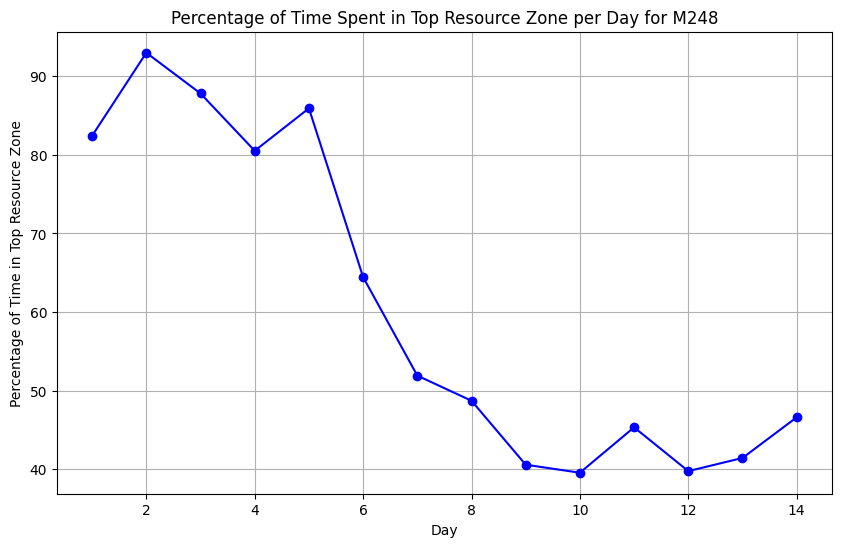

In [35]:
import pandas as pd

import matplotlib.pyplot as plt

def calculate_top_zone_percent(data, subject):
    """
    Calculate the percentage of time spent in the top resource zone per day for a specific individual.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the tracking data.
    subject (str): The ID of the individual to analyze.

    Returns:
    pd.DataFrame: A DataFrame with the percentage of time spent in the top resource zone per day.
    """
    # Filter the DataFrame for the specific individual
    df_filtered = data[data['ID'] == subject]
    
    # Group by day and zone, and calculate the percentage of time spent in each zone
    time_in_zones = df_filtered.groupby(['Day', 'zone']).size().unstack(fill_value=0)
    time_in_zones = time_in_zones.div(time_in_zones.sum(axis=1), axis=0) * 100
    
    # Identify the top resource zone for each day
    top_zones = time_in_zones.idxmax(axis=1)
    top_zone_percent = time_in_zones.max(axis=1)
    
    # Create a DataFrame with the results
    top_zone_df = pd.DataFrame({
        'Day': top_zones.index,
        'TopZone': top_zones.values,
        'PercentTime': top_zone_percent.values
    })
    
    return top_zone_df

def plot_top_zone_percent(data, subject):
    """
    Plot the percentage of time spent in the top resource zone per day for a specific individual.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the tracking data.
    subject (str): The ID of the individual to analyze.
    """
    # Calculate the top zone percentage
    top_zone_df = calculate_top_zone_percent(data, subject)
    
    # Plot the data
    plt.figure(figsize=(10, 6))
    plt.plot(top_zone_df['Day'], top_zone_df['PercentTime'], marker='o', linestyle='-', color='b')
    
    plt.xlabel('Day')
    plt.ylabel('Percentage of Time in Top Resource Zone')
    plt.title(f'Percentage of Time Spent in Top Resource Zone per Day for {subject}')
    plt.grid(True)
    plt.show()

# Example usage
plot_top_zone_percent(data=uwb, subject='M248')

## Plot percent time in zone

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def calculate_percent_zone_occupancy(data, subject):
    """
    Calculate the percentage of time spent in each zone per day for a specific individual.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the tracking data.
    subject (str): The ID of the individual to analyze.

    Returns:
    pd.DataFrame: A DataFrame with the percentage of time spent in each zone per day.
    """
    # Filter the DataFrame for the specific individual
    df_filtered = data[data['ID'] == subject]
    
    # Group by day and zone, and calculate the percentage of time spent in each zone
    time_in_zones = df_filtered.groupby(['Day', 'zone']).size().unstack(fill_value=0)
    time_in_zones = time_in_zones.div(time_in_zones.sum(axis=1), axis=0) * 100
    
    # Reset the index for plotting
    time_in_zones = time_in_zones.reset_index()
    return time_in_zones

def plot_percent_zone_occupancy(data, subject):
    """
    Plot the percentage of time spent in each zone per day for a specific individual.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the tracking data.
    subject (str): The ID of the individual to analyze.
    """
    # Calculate the time spent in zones
    time_in_zones_df = calculate_percent_zone_occupancy(data, subject)
    
    # Plot the data
    plt.figure(figsize=(6, 4))
    for zone in time_in_zones_df.columns[1:]:  # Skip the 'Day' column
        plt.plot(time_in_zones_df['Day'], time_in_zones_df[zone], marker='o', label=zone)
    
    plt.xlabel('Day')
    plt.ylabel('Percentage of Time in Zone')
    plt.title(f'Percentage of Time Spent in Zones per Day for {subject}')
    plt.legend(title='Zone')
    plt.grid(False)
    plt.show()

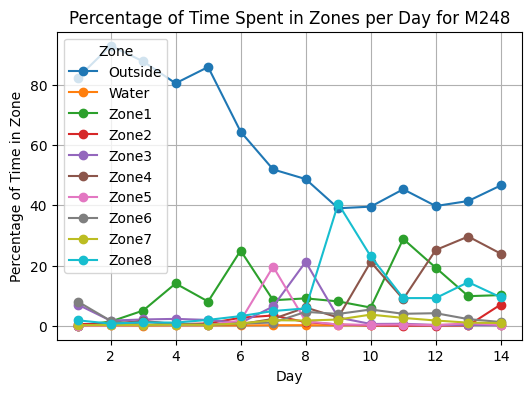

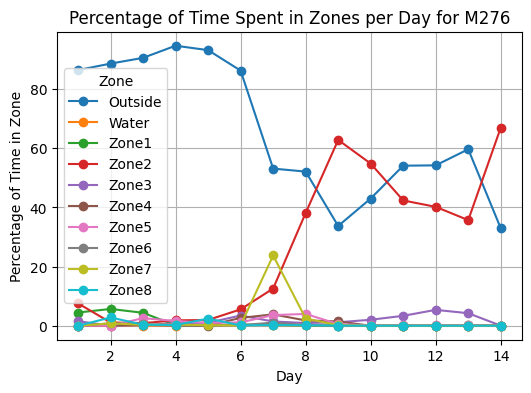

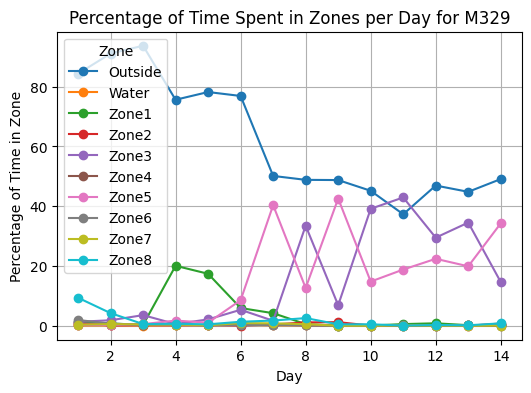

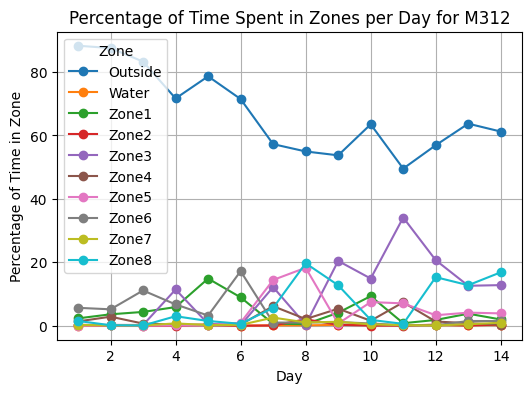

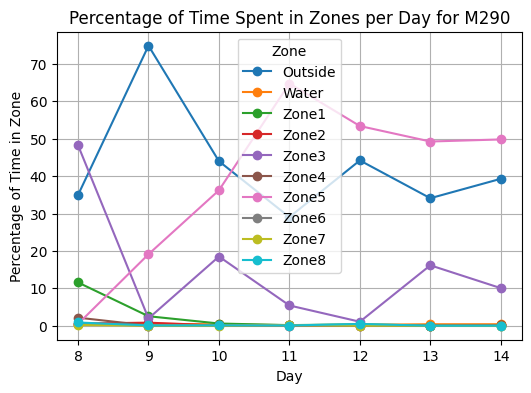

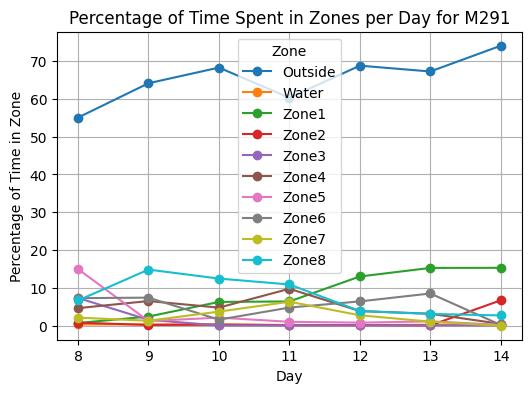

In [34]:
# Example usage
plot_percent_zone_occupancy(data=uwb, subject='M248')
plot_percent_zone_occupancy(data=uwb, subject='M276')
plot_percent_zone_occupancy(data=uwb, subject='M329')
plot_percent_zone_occupancy(data=uwb, subject='M312')
plot_percent_zone_occupancy(data=uwb, subject='M290')
plot_percent_zone_occupancy(data=uwb, subject='M291')

## Identify chasing events from uwb data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def calculate_heading(data, window=3):
    """
    Calculate the heading direction for each animal based on the last several data points.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the tracking data.
    window (int): The number of data points to use for calculating the heading direction.

    Returns:
    pd.DataFrame: The DataFrame with an additional 'heading' column.
    """
    data = data.sort_values(by='Timestamp')
    data['heading'] = np.arctan2(data['smoothed_y'].diff(window), data['smoothed_x'].diff(window))
    return data

def identify_chasing_events(data, distance_threshold=1.0, time_threshold=5, velocity_threshold=0.2, heading_threshold=np.pi/4):
    """
    Identify chasing events in the tracking data.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the tracking data.
    distance_threshold (float): The maximum distance between two animals to consider a chase (in meters).
    time_threshold (int): The minimum duration of a chase (in seconds).
    velocity_threshold (float): The minimum velocity to consider a chase (in meters/second).
    heading_threshold (float): The maximum difference in heading direction to consider a chase (in radians).

    Returns:
    pd.DataFrame: A DataFrame containing the chasing events.
    """
    chasing_events = []

    # Calculate heading direction for each animal
    data = calculate_heading(data)

    # Ensure 'Day' column is present
    if 'Day' not in data.columns:
        data['Day'] = data['Timestamp'].dt.day

    # Get unique IDs
    ids = data['ID'].unique()

    # Loop through each pair of animals
    for id1 in ids:
        for id2 in ids:
            if id1 != id2:
                # Filter data for the two animals
                data1 = data[data['ID'] == id1]
                data2 = data[data['ID'] == id2]

                # Merge data on Timestamp
                merged_data = pd.merge(data1, data2, on='Timestamp', suffixes=('_1', '_2'))

                # Calculate the distance between the two animals
                merged_data['distance'] = np.sqrt((merged_data['smoothed_x_1'] - merged_data['smoothed_x_2'])**2 + (merged_data['smoothed_y_1'] - merged_data['smoothed_y_2'])**2)

                # Calculate the velocity of the first animal
                merged_data['velocity_1'] = np.sqrt(merged_data['smoothed_x_1'].diff()**2 + merged_data['smoothed_y_1'].diff()**2) / merged_data['Timestamp'].diff().dt.total_seconds()

                # Calculate the difference in heading direction
                merged_data['heading_diff'] = np.abs(merged_data['heading_1'] - merged_data['heading_2'])

                # Identify chasing events
                chasing = (merged_data['distance'] <= distance_threshold) & (merged_data['velocity_1'] >= velocity_threshold) & (merged_data['heading_diff'] <= heading_threshold)
                chasing_periods = merged_data.loc[chasing]

                # Group by consecutive periods
                chasing_periods['group'] = (chasing_periods['Timestamp'].diff() > pd.Timedelta(seconds=1)).cumsum()
                chasing_groups = chasing_periods.groupby('group')

                # Filter groups by duration
                for _, group in chasing_groups:
                    if len(group) >= time_threshold:
                        chasing_events.append({
                            'chaser': id1,
                            'chased': id2,
                            'start_time': group['Timestamp'].iloc[0],
                            'end_time': group['Timestamp'].iloc[-1],
                            'duration': (group['Timestamp'].iloc[-1] - group['Timestamp'].iloc[0]).total_seconds(),
                            'day': group['Day_1'].iloc[0]  # Use 'Day_1' from merged data
                        })

    chasing_events_df = pd.DataFrame(chasing_events)
    print("Chasing Events DataFrame:")
    print(chasing_events_df.head())
    return chasing_events_df

def plot_chases_per_day(chasing_events):
    """
    Plot the number of chases each animal engages in per day.

    Parameters:
    chasing_events (pd.DataFrame): The DataFrame containing the chasing events.
    """
    # Count the number of chases per day for each chaser
    chases_per_day = chasing_events.groupby(['chaser', 'day']).size().unstack(fill_value=0)

    # Plot the data
    plt.figure(figsize=(6, 4))
    for chaser in chases_per_day.index:
        plt.plot(chases_per_day.columns, chases_per_day.loc[chaser], marker='o', linestyle='-', label=chaser)

    plt.xlabel('Day')
    plt.ylabel('Number of Chases')
    plt.title('Number of Chases Each Animal Engages in Per Day')
    plt.legend(title='Chaser')
    plt.grid(True)
    plt.show()

C:\Users\caleb\AppData\Local\Temp\ipykernel_17956\4242035935.py:71: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chasing_periods['group'] = (chasing_periods['FieldTime'].diff() > pd.Timedelta(seconds=1)).cumsum()
C:\Users\caleb\AppData\Local\Temp\ipykernel_17956\4242035935.py:71: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chasing_periods['group'] = (chasing_periods['FieldTime'].diff() > pd.Timedelta(seconds=1)).cumsum()
C:\Users\caleb\AppData\Local\Temp\ipykernel_17956\4242035935.py:71: SettingWithCopyW

Chasing Events DataFrame:
  chaser chased              start_time                end_time  duration  day
0   M248   M329 2024-11-09 03:36:08.442 2024-11-09 03:36:08.442     0.000    2
1   M248   M329 2024-11-09 03:36:10.325 2024-11-09 03:36:10.325     0.000    2
2   M248   M329 2024-11-13 16:36:59.288 2024-11-13 16:37:00.222     0.934    7
3   M248   M329 2024-11-15 12:50:34.969 2024-11-15 12:50:34.969     0.000    8
4   M248   M329 2024-11-15 22:28:44.869 2024-11-15 22:28:44.869     0.000    9


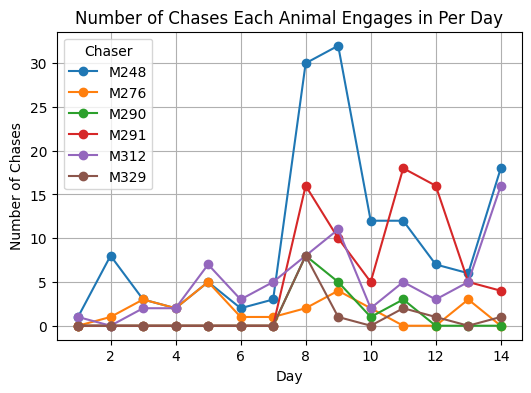

In [12]:
# Example usage
chasing_events = identify_chasing_events(data=uwb, distance_threshold=0.5, time_threshold=1, velocity_threshold=0.2, heading_threshold=np.pi/4)
plot_chases_per_day(chasing_events)